**Téléchargement des données**

In [ ]:
!rm -rf sample_data
!pip install -q --upgrade --no-cache-dir gdown
!gdown --folder https://drive.google.com/drive/folders/1O4Fn_jbAEcKIksXHmQIMcHTyaDw4wt9x

Retrieving folder list
Processing file 1HylyDnApIRNMloREqvKYWWhB88q7Z1Cg videos01.tgz
Processing file 1tqR2FF8OlXGmYACw3TSxyS6QGDit_s3a videos02.tgz
Processing file 1Dk7l-jAAvNLlb0faypAco88XYLWPa9g_ videos03.tgz
Processing file 1x0mDr-QHQtDkfcQAm9bKdWBR7Lj3fLcV videos04.tgz
Processing file 1PCjldH6hmVYV7EObPf-jtNWCtDK60o6n videos05.tgz
Retrieving folder list completed
Building directory structure
Building directory structure completed
Downloading...
From: https://drive.google.com/uc?id=1HylyDnApIRNMloREqvKYWWhB88q7Z1Cg
To: /content/videos/videos01.tgz
100% 975M/975M [00:12<00:00, 75.2MB/s]
Downloading...
From: https://drive.google.com/uc?id=1tqR2FF8OlXGmYACw3TSxyS6QGDit_s3a
To: /content/videos/videos02.tgz
100% 1.03G/1.03G [00:21<00:00, 48.8MB/s]
Downloading...
From: https://drive.google.com/uc?id=1Dk7l-jAAvNLlb0faypAco88XYLWPa9g_
To: /content/videos/videos03.tgz
100% 1.07G/1.07G [00:14<00:00, 74.6MB/s]
Downloading...
From: https://drive.google.com/uc?id=1x0mDr-QHQtDkfcQAm9bKdWBR7Lj3fL

**Définition des fonctions**

In [ ]:
import os
import tarfile

def extract_tgz_avi_videos(tgz_file_path, output_folder_path, task_progress=True):
  with tarfile.open(tgz_file_path, "r:gz") as tar_file:

    task_title = "\rExtraction des vidéos de " + os.path.basename(tgz_file_path) + " - "
    nb_files_task = len(tar_file.getmembers())

    for i, member in enumerate(tar_file.getmembers()):
      if task_progress:
        print(task_title + "%.2f" % ((i + 1) / nb_files_task * 100) + " %", end='')

      if member.isreg() and os.path.splitext(member.name)[1] == ".avi":
        member.name = os.path.basename(member.name)
        tar_file.extract(member, output_folder_path)
      
      if task_progress and i != nb_files_task - 1:
        print("\r", end='')

def create_tgz_file_from_folder(folder_path, name_tar_file, task_progress=True):
  with tarfile.open(name_tar_file, 'w') as tar_file:

    task_title = "\rCompressions des fichiers de " + folder_path + " - "
    nb_files_task = len(os.listdir(folder_path))


    for i, member in enumerate(os.listdir(folder_path)):
      if task_progress:
        print(task_title + "%.2f" % ((i + 1) / nb_files_task * 100) + " %", end='')
      tar_file.add(folder_path + "/" + member, member)

      if task_progress and i != nb_files_task - 1:
        print("\r", end='')

def delete_file(file_path):
  os.remove(file_path)

def rename_file(old_name, new_name):
  os.rename(old_name, new_name)

In [ ]:
import subprocess
from google.colab import output
from IPython.display import display, HTML
from base64 import b64encode

def convert_avi_video_to_mp4_video(avi_video_path, compression=True):
  mp4_video_path = os.path.splitext(avi_video_path)[0] + ".mp4"
  p1 = subprocess.run(f"ffmpeg -i {avi_video_path} -c:v copy -c:a copy {mp4_video_path}", shell=True)

  if compression:
    print("Compression de la video mp4 en cours (cette étape peut prendre du temps)")

    compressed_mp4_video_path = os.path.splitext(mp4_video_path)[0] + "_compressed.mp4"
    p2 = subprocess.run(f"ffmpeg -i {mp4_video_path} -vcodec libx264 {compressed_mp4_video_path}", shell=True)

    delete_file(mp4_video_path)
    rename_file(compressed_mp4_video_path, mp4_video_path)
    output.clear()

def display_mp4_video(mp4_video_path):
  # Vidéo mp4 compressée conseillée sinon trop long
  video = open(mp4_video_path,'rb').read()
  data_url = "data:video/mp4;base64," + b64encode(video).decode()
  display(HTML("""
  <video width=400 controls>
        <source src="%s" type="video/mp4">
  </video>
  """ % data_url))

In [ ]:
!pip install -q mediapipe
import mediapipe as mp
output.clear()

import cv2
import numpy as np
from google.colab.patches import cv2_imshow

def convert_frame_to_hand_landmarks_with_mediapipe(frame, id_frame=0, alert_multiple_hands=False, print_metrics=False, draw_landmarks=False, write_frame_nb=True, plot_landmarks=False):
  mp_hands = mp.solutions.hands
  mp_drawing = mp.solutions.drawing_utils
  mp_drawing_styles = mp.solutions.drawing_styles

  # Detection de la main
  with mp_hands.Hands(static_image_mode=True, max_num_hands=2, min_detection_confidence=0.5) as hands_detector:
    results = hands_detector.process(frame)

  if results.multi_handedness is not None:
    # Affichage des résultats si plusieurs mains detectées
    if alert_multiple_hands and len(results.multi_handedness) > 1:
      print("\n" + str(len(results.multi_handedness)) + " mains detectées !")
      print_metrics = True
      draw_landmarks = True
      plot_landmarks = True

    # Affichage des métriques
    if print_metrics:
      print(results.multi_handedness)

    # Affichage des landmarks sur l'image
    if draw_landmarks:
      annotate_frame_with_landmarks(frame, results, id_frame=id_frame, display_img=True)

    # Afficahge des landmarks en 3d
    if plot_landmarks:
      for hand_world_landmarks in results.multi_hand_world_landmarks:
        mp_drawing.plot_landmarks(hand_world_landmarks, mp_hands.HAND_CONNECTIONS, azimuth=5)
  
  return results

def annotate_frame_with_landmarks(frame, results, write_frame_nb=True, id_frame=0, display_img=False):
  mp_hands = mp.solutions.hands
  mp_drawing = mp.solutions.drawing_utils
  mp_drawing_styles = mp.solutions.drawing_styles

  annotated_frame =  cv2.cvtColor(frame.copy(), cv2.COLOR_RGB2BGR)
  if results.multi_hand_landmarks is not None:
    for hand_landmarks in results.multi_hand_landmarks:
      mp_drawing.draw_landmarks(
            annotated_frame, hand_landmarks, mp_hands.HAND_CONNECTIONS,
            mp_drawing_styles.get_default_hand_landmarks_style(),
            mp_drawing_styles.get_default_hand_connections_style())
  if write_frame_nb:
    cv2.putText(annotated_frame, "Frame " + str(id_frame), (0, 15), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 0), 1)
  if display_img:
    cv2_imshow(annotated_frame)
  return annotated_frame

def convert_landmarks_results_mediapipe_to_txt(results):
  txt = ";"

  # Si au moins une main est detectée
  if results.multi_hand_landmarks is not None:
    
    best_hand = 0
    # Si plus d'une seule main est detectée
    if len(results.multi_handedness) > 1:
      scores = [results.multi_handedness[i].classification[0].score for i in range(len(results.multi_handedness))]
      best_hand = np.argmax(scores)

    # Concaténation des landmarks
    txt = ""
    for i in range(21):
      txt += "{:.7f}".format(results.multi_hand_landmarks[best_hand].landmark[i].x) + ";"
      txt += "{:.7f}".format(results.multi_hand_landmarks[best_hand].landmark[i].y) + ";"
      txt += "{:.7f}".format(results.multi_hand_landmarks[best_hand].landmark[i].z) + ";"
  return txt + "\n"

In [ ]:
def convert_video_to_hand_landmarks_txt(video_path, hand_landmarks_txt_path, annotated_video_path, make_annotated_video=True, alert_multiple_hands=False, task_progress=True):

  # Création du fichier txt
  with open(hand_landmarks_txt_path, 'w') as txt_file:

    # Capture de la vidéo
    video_capture = cv2.VideoCapture(video_path)

    task_title = "\rCalcul des landmarks de la vidéo " + os.path.basename(video_path) + " - "
    nb_frames = int(video_capture.get(cv2.CAP_PROP_FRAME_COUNT))
    id_frame = 0

    # Création de la vidéo annotée
    if make_annotated_video:
      annotated_video = cv2.VideoWriter(annotated_video_path, cv2.VideoWriter_fourcc(*'DIVX'), 30, (640, 480))

    # Lecture de la première frame
    success, frame = video_capture.read()

    while success:
      # Affichage de l'avancement
      if task_progress:
        print(task_title + "%.2f" % ((id_frame + 1) / nb_frames * 100) + " %", end='')

      # Conversion de l'image cv2 BGR en RGB
      frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

      results = convert_frame_to_hand_landmarks_with_mediapipe(frame, id_frame=id_frame, alert_multiple_hands=alert_multiple_hands)

      # Ecriture du fichier txt
      txt_file.write(convert_landmarks_results_mediapipe_to_txt(results))

      # Ajout de la frame annotée à la vidéo de sortie
      if make_annotated_video:
        annotated_video.write(annotate_frame_with_landmarks(frame, results, id_frame=id_frame))

      # Frame suivante
      success, frame = video_capture.read()
      if task_progress and id_frame != nb_frames - 1:
        print("\r", end='')
      id_frame += 1
    
    # Publication de la vidéo annotée
    if make_annotated_video:
      annotated_video.release()

    cv2.destroyAllWindows()

In [ ]:
import time

def get_millis():
  return round(time.time() * 1000);

def convert_milliseconds(milliseconds):
  seconds = format(int((milliseconds / 1000) % 60), '02')
  minutes = format(int((milliseconds/ (1000*60)) % 60), '02')
  hours = format(int((milliseconds / (1000* 60 * 60)) % 24), '02')

  if int(hours) > 0:
    return hours + 'h ' + minutes + 'm ' + seconds + 's'
  elif int(minutes) > 0:
    return minutes + 'm ' + seconds + 's'
  else:
    return seconds + 's ' + str(milliseconds % 1000) + "ms"

**Tests**

In [ ]:
tgz_file_path = "/content/videos/videos01.tgz"
avi_videos_folder_path = "/content/videos/videos01"

extract_tgz_avi_videos(tgz_file_path, avi_videos_folder_path)

Extraction des vidéos de videos01.tgz - 100.00 %

[classification {
  index: 0
  score: 0.9988266229629517
  label: "Left"
}
]


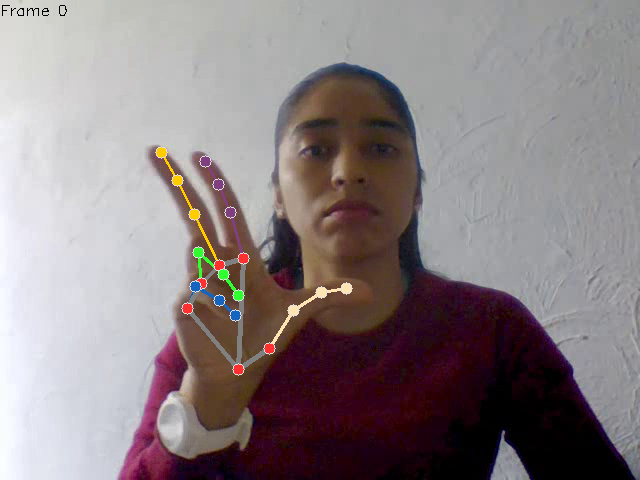

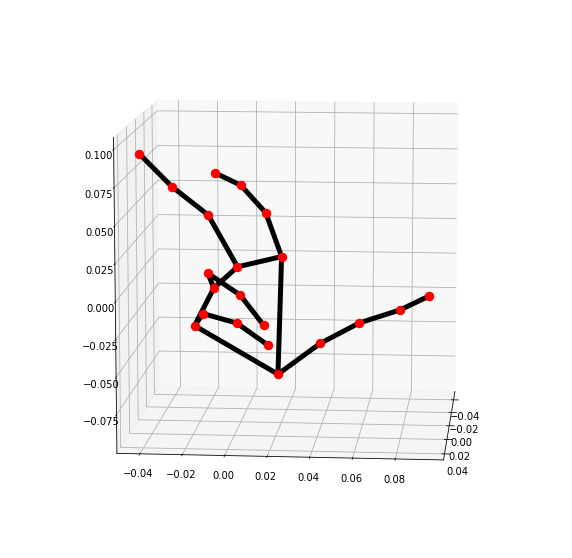

Durée : 01s 295ms


In [ ]:
# Test sur une frame d'une vidéo

video_test_path = "/content/videos/videos01/1CM1_1_R_#217.avi"

video_capture = cv2.VideoCapture(video_test_path)
for i in range(50):
  video_capture.read()

success, frame = video_capture.read()
frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

tic = get_millis()
results = convert_frame_to_hand_landmarks_with_mediapipe(frame, print_metrics=True, plot_landmarks=True, draw_landmarks=True)
tac = get_millis()
print("Durée :", convert_milliseconds(tac-tic))

Calcul des landmarks de la vidéo 1CM1_1_R_#217.avi - 26.81 %
2 mains detectées !
[classification {
  index: 0
  score: 0.9982457756996155
  label: "Left"
}
, classification {
  index: 1
  score: 0.9167919158935547
  label: "Right"
}
]


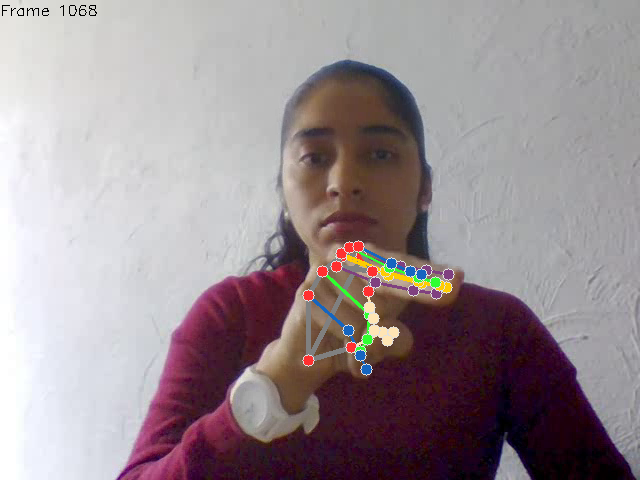

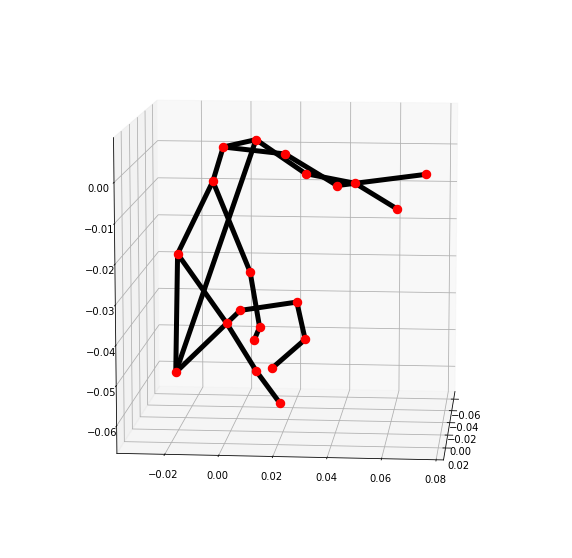

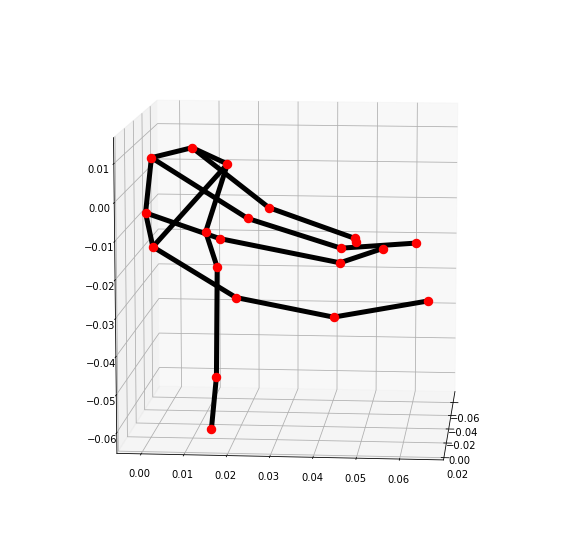

Calcul des landmarks de la vidéo 1CM1_1_R_#217.avi - 35.34 %
2 mains detectées !
[classification {
  index: 0
  score: 0.9991708397865295
  label: "Left"
}
, classification {
  index: 1
  score: 0.9934210777282715
  label: "Right"
}
]


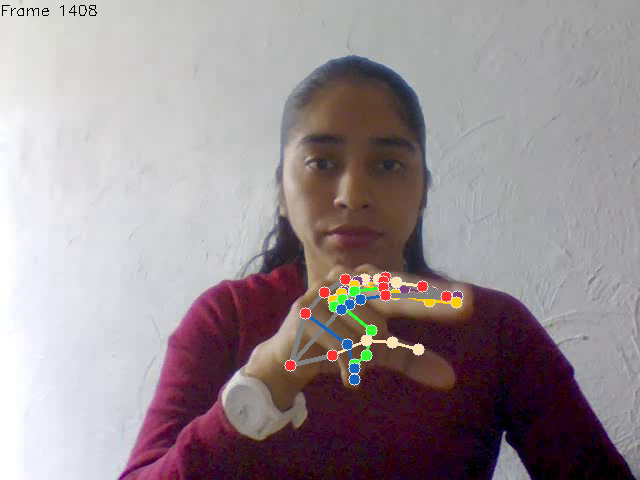

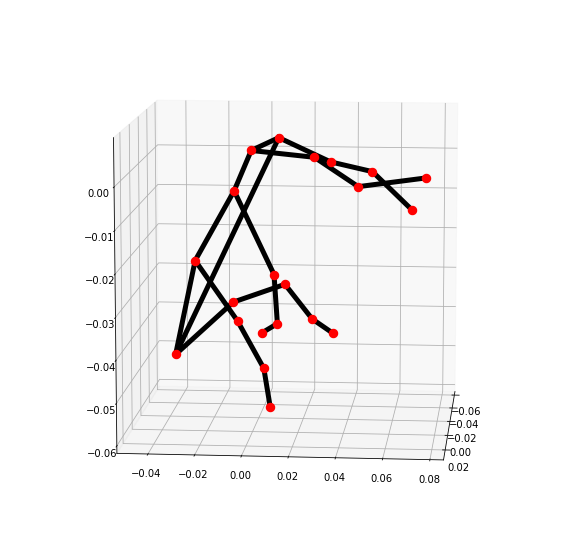

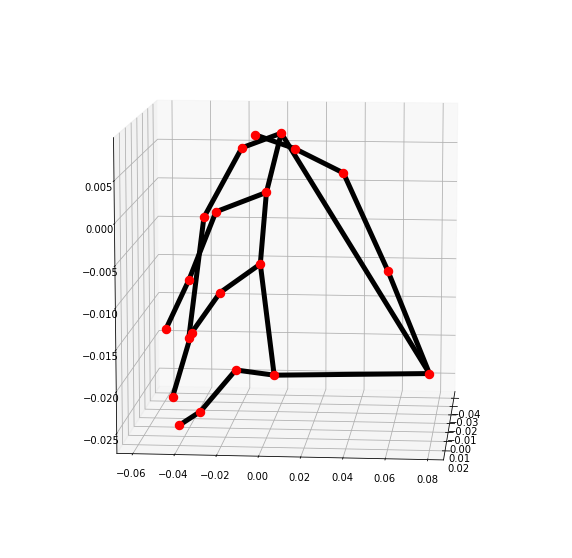

Durée : 05m 55s


In [ ]:
# Test sur une vidéo entière

hand_landmarks_txt_test_path = "/content/videos/videos01/1CM1_1_R_#218.txt"
annotated_video_test_path = "/content/videos/videos01/1CM1_1_R_#218_annotated.avi"

tic = round(time.time() * 1000)
convert_video_to_hand_landmarks_txt(video_test_path, hand_landmarks_txt_test_path, annotated_video_test_path, alert_multiple_hands=True)
tac = round(time.time() * 1000)
print("Durée :", convert_milliseconds(tac-tic))

In [ ]:
convert_avi_video_to_mp4_video("/content/videos/videos01/1CM1_1_R_#218_annotated.avi")

In [ ]:
display_mp4_video("/content/videos/videos01/1CM1_1_R_#218_annotated.mp4")

**Automatisation pour toutes les vidéos**

In [ ]:
tgz_file_path = "/content/videos/videos01.tgz"
avi_videos_folder_path = "/content/videos/videos01"
hand_landmarks_txt_folder_path = "/content/videos01_txt"
annotated_videos_folder_path  = "/content/videos01_annotated"

!mkdir "/content/videos01_txt"
!mkdir "/content/videos01_annotated"

extract_tgz_avi_videos(tgz_file_path, avi_videos_folder_path)
print("\n\nCALCUL DES LANDMARKS DE LA MAIN SUR LE DOSSIER " + avi_videos_folder_path + "\n")

nb_video_folder = len(os.listdir(avi_videos_folder_path))

debut_process = get_millis()

for i, avi_video in enumerate(os.listdir(avi_videos_folder_path)):
  video_path = avi_videos_folder_path + "/" + avi_video
  hand_landmarks_txt_path = hand_landmarks_txt_folder_path + '/' + os.path.splitext(avi_video)[0] + ".txt"
  annotated_video_path = annotated_videos_folder_path + '/' + os.path.splitext(avi_video)[0] + "_annotated.avi"

  print("Vidéo " + str(i+1) + "/" + str(nb_video_folder))

  debut_video = get_millis()
  convert_video_to_hand_landmarks_txt(video_path, hand_landmarks_txt_path, annotated_video_path)
  fin_video = get_millis()
  print("\nDurée : " + convert_milliseconds(fin_video - debut_video) + "\n")t

fin_process = get_millis()
print("\nDUREE TOTALE DU PROCESS : " + convert_milliseconds(fin_process - debut_process) + "\n")


txt_tgz_file = "/content/videos01_txt.tgz"
create_tgz_file_from_folder(txt_tgz_file, hand_landmarks_txt_folder_path)

annotated_videos_tgz_file = "/content/videos01_annotated.tgz"
create_tgz_file_from_folder(annotated_videos_tgz_file, annotated_videos_folder_path)

!rf -rf $avi_videos_folder_path
!rm -rf $hand_landmarks_txt_folder_path
!rm -rf $annotated_videos_folder_path

In [ ]:
for video_file in ['videos01', 'videos02', 'videos03', 'videos04', 'videos05']:

  tgz_file_path = "/content/videos/" + video_file + ".tgz"
  avi_videos_folder_path = "/content/videos/" + video_file
  hand_landmarks_txt_folder_path = "/content/" + video_file + "_txt"
  annotated_videos_folder_path  = "/content/" + video_file + "_annotated"

  !mkdir $hand_landmarks_txt_folder_path
  !mkdir $annotated_videos_folder_path

  extract_tgz_avi_videos(tgz_file_path, avi_videos_folder_path)
  print("\n\nCALCUL DES LANDMARKS DE LA MAIN SUR LE DOSSIER " + video_file + "\n")

  nb_video_folder = len(os.listdir(avi_videos_folder_path))

  debut_process = get_millis()

  for i, avi_video in enumerate(os.listdir(avi_videos_folder_path)):
    video_path = avi_videos_folder_path + "/" + avi_video
    hand_landmarks_txt_path = hand_landmarks_txt_folder_path + '/' + os.path.splitext(avi_video)[0] + ".txt"
    annotated_video_path = annotated_videos_folder_path + '/' + os.path.splitext(avi_video)[0] + "_annotated.avi"

    print("Vidéo " + str(i+1) + "/" + str(nb_video_folder))

    debut_video = get_millis()
    convert_video_to_hand_landmarks_txt(video_path, hand_landmarks_txt_path, annotated_video_path)
    fin_video = get_millis()
    print("\nDurée : " + convert_milliseconds(fin_video - debut_video) + "\n")

  fin_process = get_millis()
  print("\nDUREE TOTALE DU PROCESS : " + convert_milliseconds(fin_process - debut_process) + "\n")


  txt_tgz_file = "/content/" + video_file + "_txt.tgz"
  create_tgz_file_from_folder(hand_landmarks_txt_folder_path, txt_tgz_file)
  print("\n")

  annotated_videos_tgz_file = "/content/" + video_file + "_annotated.tgz"
  create_tgz_file_from_folder(annotated_videos_folder_path, annotated_videos_tgz_file)
  print("\n")

  !rm -rf $avi_videos_folder_path
  !rm -rf $hand_landmarks_txt_folder_path
  !rm -rf $annotated_videos_folder_path

Extraction des vidéos de videos01.tgz - 100.00 %

CALCUL DES LANDMARKS DE LA MAIN SUR LE DOSSIER videos01

Vidéo 1/40
Calcul des landmarks de la vidéo 1CM1_3_R_#226.avi - 100.00 %
Durée : 05m 35s

Vidéo 2/40
Calcul des landmarks de la vidéo 1CM42_13_R_#143.avi - 100.00 %
Durée : 04m 17s

Vidéo 3/40
Calcul des landmarks de la vidéo 1CM42_12_R_#160.avi - 100.00 %
Durée : 05m 40s

Vidéo 4/40
Calcul des landmarks de la vidéo 1CM42_13_R_#141.avi - 100.00 %
Durée : 04m 06s

Vidéo 5/40
Calcul des landmarks de la vidéo 1CM1_1_R_#220.avi - 100.00 %
Durée : 04m 05s

Vidéo 6/40
Calcul des landmarks de la vidéo 1CM1_1_R_#219.avi - 100.00 %
Durée : 04m 07s

Vidéo 7/40
Calcul des landmarks de la vidéo 1CM42_15_R_#197.avi - 100.00 %
Durée : 04m 32s

Vidéo 8/40
Calcul des landmarks de la vidéo 1CM42_17_R_#189.avi - 100.00 %
Durée : 03m 55s

Vidéo 9/40
Calcul des landmarks de la vidéo 1CM42_13_R_#144.avi - 100.00 %
Durée : 04m 15s

Vidéo 10/40
Calcul des landmarks de la vidéo 1CM42_11_R_#206.avi - 100.